<a href="https://colab.research.google.com/github/aryan757/Research_solution/blob/main/Research_Interpretablity.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [1]:
import pandas as pd
import numpy as np

In [2]:
df = pd.read_csv('/content/drive/MyDrive/labeled_data.csv')

In [3]:
df

,Unnamed: 0,count,hate_speech,offensive_language,neither,class,tweet
0,0,3,0,0,3,2,!!! RT @mayasolovely: As a woman you shouldn't...
1,1,3,0,3,0,1,!!!!! RT @mleew17: boy dats cold...tyga dwn ba...
2,2,3,0,3,0,1,!!!!!!! RT @UrKindOfBrand Dawg!!!! RT @80sbaby...
3,3,3,0,2,1,1,!!!!!!!!! RT @C_G_Anderson: @viva_based she lo...
4,4,6,0,6,0,1,!!!!!!!!!!!!! RT @ShenikaRoberts: The shit you...
...,...,...,...,...,...,...,...
24778,25291,3,0,2,1,1,you's a muthaf***in lie &#8220;@LifeAsKing: @2...
24779,25292,3,0,1,2,2,"you've gone and broke the wrong heart baby, an..."
24780,25294,3,0,3,0,1,young buck wanna eat!!.. dat nigguh like I ain...
24781,25295,6,0,6,0,1,youu got wild bitches tellin you lies


In [4]:


df = df[['class', 'tweet']]


In [47]:
df

,class,tweet
0,2,!!! RT @mayasolovely: As a woman you shouldn't...
1,1,!!!!! RT @mleew17: boy dats cold...tyga dwn ba...
2,1,!!!!!!! RT @UrKindOfBrand Dawg!!!! RT @80sbaby...
3,1,!!!!!!!!! RT @C_G_Anderson: @viva_based she lo...
4,1,!!!!!!!!!!!!! RT @ShenikaRoberts: The shit you...
...,...,...
24778,1,you's a muthaf***in lie &#8220;@LifeAsKing: @2...
24779,2,"you've gone and broke the wrong heart baby, an..."
24780,1,young buck wanna eat!!.. dat nigguh like I ain...
24781,1,youu got wild bitches tellin you lies


In [5]:


import re

def clean_text(text):
  # Remove special characters
  text = re.sub(r"[^a-zA-Z0-9]+", ' ', text)
  # Convert to lowercase
  text = text.lower()
  return text

df['tweet'] = df['tweet'].apply(clean_text)
df


<ipython-input-5-bf78d31242e1>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['tweet'] = df['tweet'].apply(clean_text)


,class,tweet
0,2,rt mayasolovely as a woman you shouldn t comp...
1,1,rt mleew17 boy dats cold tyga dwn bad for cuf...
2,1,rt urkindofbrand dawg rt 80sbaby4life you eve...
3,1,rt c g anderson viva based she look like a tr...
4,1,rt shenikaroberts the shit you hear about me ...
...,...,...
24778,1,you s a muthaf in lie 8220 lifeasking 20 pearl...
24779,2,you ve gone and broke the wrong heart baby and...
24780,1,young buck wanna eat dat nigguh like i aint fu...
24781,1,youu got wild bitches tellin you lies


In [6]:
df

,class,tweet
0,2,rt mayasolovely as a woman you shouldn t comp...
1,1,rt mleew17 boy dats cold tyga dwn bad for cuf...
2,1,rt urkindofbrand dawg rt 80sbaby4life you eve...
3,1,rt c g anderson viva based she look like a tr...
4,1,rt shenikaroberts the shit you hear about me ...
...,...,...
24778,1,you s a muthaf in lie 8220 lifeasking 20 pearl...
24779,2,you ve gone and broke the wrong heart baby and...
24780,1,young buck wanna eat dat nigguh like i aint fu...
24781,1,youu got wild bitches tellin you lies


In [7]:
df.to_csv('cleaned_data.csv', index=False)

In [8]:
df.iloc[0,1]

' rt mayasolovely as a woman you shouldn t complain about cleaning up your house amp as a man you should always take the trash out '

In [9]:
df.head()["tweet"]

,tweet
0,rt mayasolovely as a woman you shouldn t comp...
1,rt mleew17 boy dats cold tyga dwn bad for cuf...
2,rt urkindofbrand dawg rt 80sbaby4life you eve...
3,rt c g anderson viva based she look like a tr...
4,rt shenikaroberts the shit you hear about me ...


In [10]:
for i in df.head()["tweet"]:
  print(i)

 rt mayasolovely as a woman you shouldn t complain about cleaning up your house amp as a man you should always take the trash out 
 rt mleew17 boy dats cold tyga dwn bad for cuffin dat hoe in the 1st place 
 rt urkindofbrand dawg rt 80sbaby4life you ever fuck a bitch and she start to cry you be confused as shit
 rt c g anderson viva based she look like a tranny
 rt shenikaroberts the shit you hear about me might be true or it might be faker than the bitch who told it to ya 57361 


In [13]:


!pip install sentence-transformers

from sentence_transformers import SentenceTransformer

model = SentenceTransformer('all-mpnet-base-v2')

# Assuming 'df' is your DataFrame with the 'tweet' column
sentences = df['tweet'].tolist()

embeddings = model.encode(sentences)

# Add embeddings as a new column to your DataFrame
df['embeddings'] = embeddings.tolist()

df.head()

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(
<ipython-input-13-79347e94c54b>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['embeddings'] = embeddings.tolist()


,class,tweet,embeddings
0,2,rt mayasolovely as a woman you shouldn t comp...,"[0.01799074187874794, 0.08543715626001358, -0...."
1,1,rt mleew17 boy dats cold tyga dwn bad for cuf...,"[-0.011827980168163776, -0.045914795249700546,..."
2,1,rt urkindofbrand dawg rt 80sbaby4life you eve...,"[0.04430725798010826, 0.00010491483408259228, ..."
3,1,rt c g anderson viva based she look like a tr...,"[0.03068467602133751, 0.04208562523126602, 0.0..."
4,1,rt shenikaroberts the shit you hear about me ...,"[0.08261794596910477, 0.0025372204836457968, -..."


In [14]:
df

,class,tweet,embeddings
0,2,rt mayasolovely as a woman you shouldn t comp...,"[0.01799074187874794, 0.08543715626001358, -0...."
1,1,rt mleew17 boy dats cold tyga dwn bad for cuf...,"[-0.011827980168163776, -0.045914795249700546,..."
2,1,rt urkindofbrand dawg rt 80sbaby4life you eve...,"[0.04430725798010826, 0.00010491483408259228, ..."
3,1,rt c g anderson viva based she look like a tr...,"[0.03068467602133751, 0.04208562523126602, 0.0..."
4,1,rt shenikaroberts the shit you hear about me ...,"[0.08261794596910477, 0.0025372204836457968, -..."
...,...,...,...
24778,1,you s a muthaf in lie 8220 lifeasking 20 pearl...,"[-0.010630103759467602, 0.02123507671058178, 0..."
24779,2,you ve gone and broke the wrong heart baby and...,"[-0.0080037210136652, 0.06476274132728577, 0.0..."
24780,1,young buck wanna eat dat nigguh like i aint fu...,"[0.0304896030575037, 0.03597366064786911, 0.04..."
24781,1,youu got wild bitches tellin you lies,"[0.014177223667502403, 0.09115222096443176, -0..."


In [15]:
import numpy as np

# Check if embeddings are normalized
norms = np.array([np.linalg.norm(x) for x in df['embeddings']]) # Calculate norm for each embedding individually
not_normalized = (norms != 1).any()

if not_normalized:
    # Normalize embeddings
    df['embeddings'] = df['embeddings'].apply(lambda x: x / np.linalg.norm(x))

    # Remove outliers (optional, you can adjust the threshold)
    # This example removes embeddings with a norm significantly different from 1
    threshold = 1.1
    df = df[df['embeddings'].apply(lambda x: 0.9 <= np.linalg.norm(x) <= threshold)]

# Now all embeddings should be normalized


<ipython-input-15-3009e3deac39>:9: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['embeddings'] = df['embeddings'].apply(lambda x: x / np.linalg.norm(x))


In [16]:
df

,class,tweet,embeddings
0,2,rt mayasolovely as a woman you shouldn t comp...,"[0.01799074183487002, 0.08543715605163948, -0...."
1,1,rt mleew17 boy dats cold tyga dwn bad for cuf...,"[-0.011827980610300524, -0.04591479696602218, ..."
2,1,rt urkindofbrand dawg rt 80sbaby4life you eve...,"[0.044307257127048624, 0.00010491483206263856,..."
3,1,rt c g anderson viva based she look like a tr...,"[0.030684677071572984, 0.04208562667171847, 0...."
4,1,rt shenikaroberts the shit you hear about me ...,"[0.08261794859895215, 0.0025372205644091537, -..."
...,...,...,...
24778,1,you s a muthaf in lie 8220 lifeasking 20 pearl...,"[-0.010630104019698414, 0.02123507723042819, 0..."
24779,2,you ve gone and broke the wrong heart baby and...,"[-0.0080037212894812, 0.06476274355907273, 0.0..."
24780,1,young buck wanna eat dat nigguh like i aint fu...,"[0.030489604009519788, 0.03597366177112098, 0...."
24781,1,youu got wild bitches tellin you lies,"[0.014177223984195537, 0.09115222300060494, -0..."


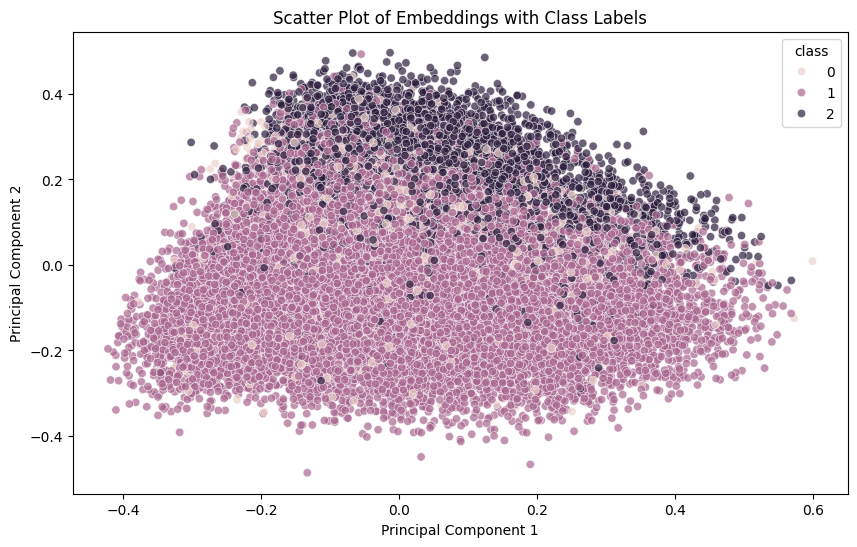

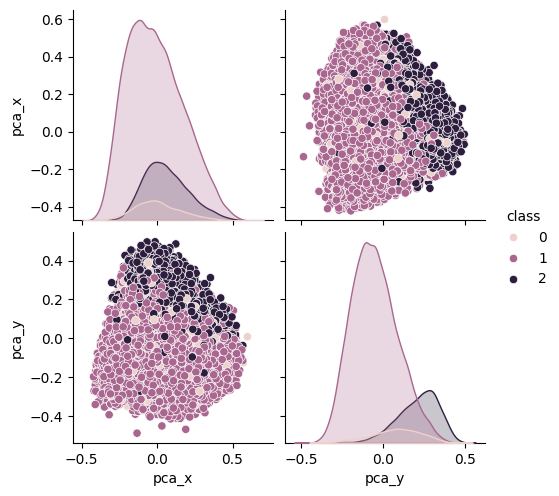

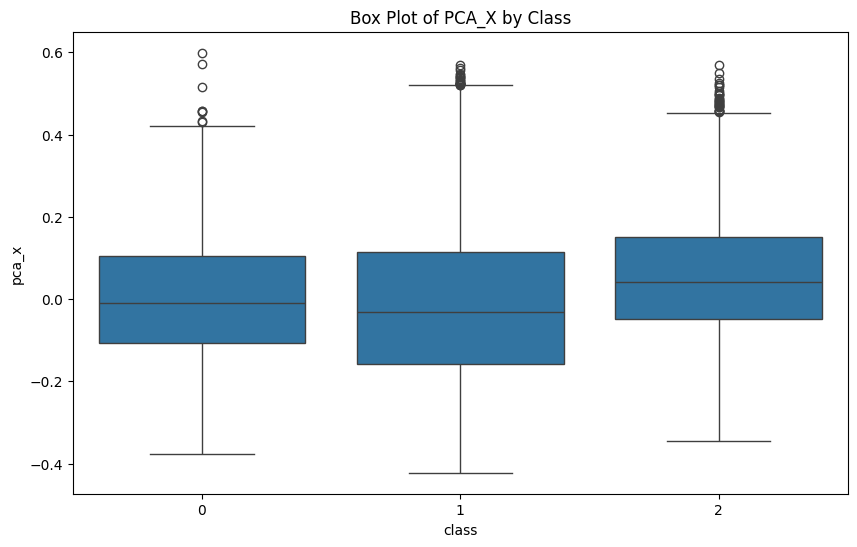

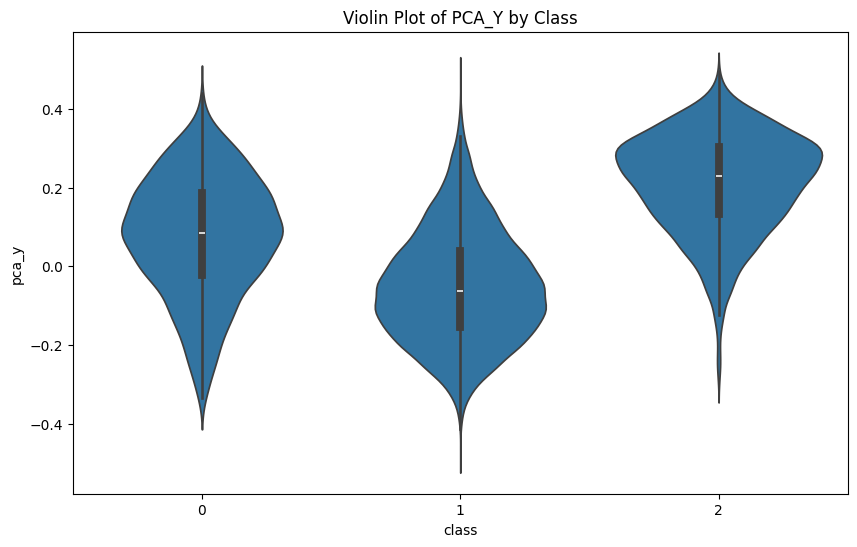

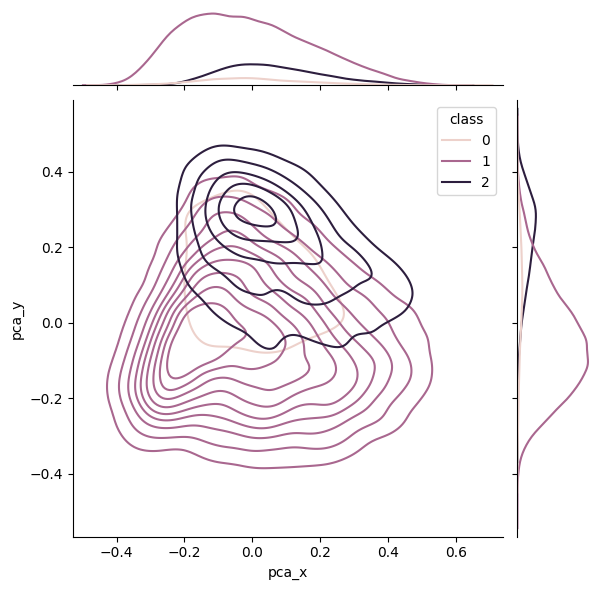

In [20]:

import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA
import seaborn as sns

# Reduce dimensionality for visualization
pca = PCA(n_components=2)
embeddings_2d = pca.fit_transform(np.array(df['embeddings'].tolist()))

# Add the reduced embeddings to the DataFrame
df['pca_x'] = embeddings_2d[:, 0]
df['pca_y'] = embeddings_2d[:, 1]

# 1. Scatter plot with class labels
plt.figure(figsize=(10, 6))
sns.scatterplot(x='pca_x', y='pca_y', hue='class', data=df, alpha=0.7)
plt.title('Scatter Plot of Embeddings with Class Labels')
plt.xlabel('Principal Component 1')
plt.ylabel('Principal Component 2')
plt.show()

# 2. Pairplot
sns.pairplot(df[['pca_x', 'pca_y', 'class']], hue='class')
plt.show()

# 3. Box plot
plt.figure(figsize=(10, 6))
sns.boxplot(x='class', y='pca_x', data=df)
plt.title('Box Plot of PCA_X by Class')
plt.show()

# 4. Violin plot
plt.figure(figsize=(10, 6))
sns.violinplot(x='class', y='pca_y', data=df)
plt.title('Violin Plot of PCA_Y by Class')
plt.show()

# 5.  Jointplot
sns.jointplot(x='pca_x', y='pca_y', data=df, hue='class', kind='kde')
plt.show()


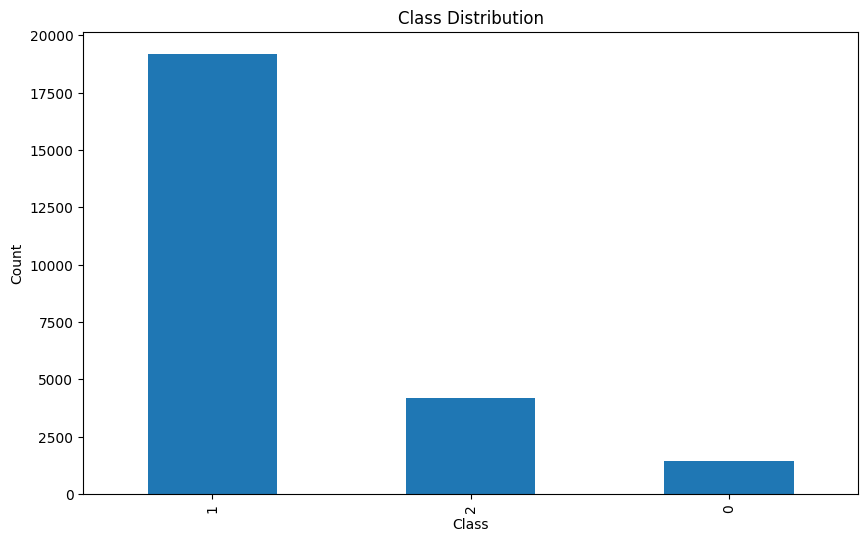

In [17]:

import matplotlib.pyplot as plt

# Count the occurrences of each class
class_counts = df['class'].value_counts()

# Create a bar plot
plt.figure(figsize=(10, 6))
class_counts.plot(kind='bar')
plt.title('Class Distribution')
plt.xlabel('Class')
plt.ylabel('Count')
plt.show()


In [18]:
# Create a mapping dictionary
class_mapping = {
    1: "offensive speech",
    0: "hate speech",
    2: "neither offensive nor hate"
}

# Apply the mapping to the 'class' column
df['class_label'] = df['class'].map(class_mapping)

# Display the updated DataFrame
df.head()


,class,tweet,embeddings,class_label
0,2,rt mayasolovely as a woman you shouldn t comp...,"[0.01799074183487002, 0.08543715605163948, -0....",neither offensive nor hate
1,1,rt mleew17 boy dats cold tyga dwn bad for cuf...,"[-0.011827980610300524, -0.04591479696602218, ...",offensive speech
2,1,rt urkindofbrand dawg rt 80sbaby4life you eve...,"[0.044307257127048624, 0.00010491483206263856,...",offensive speech
3,1,rt c g anderson viva based she look like a tr...,"[0.030684677071572984, 0.04208562667171847, 0....",offensive speech
4,1,rt shenikaroberts the shit you hear about me ...,"[0.08261794859895215, 0.0025372205644091537, -...",offensive speech


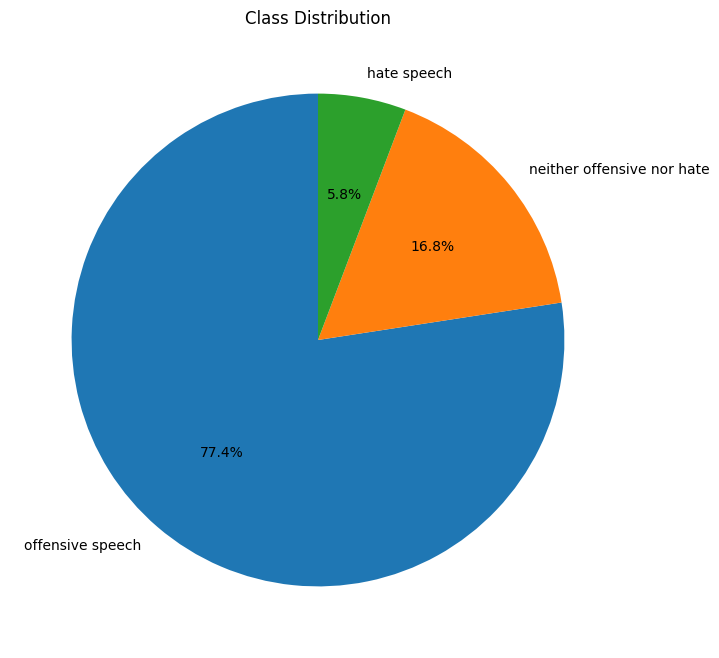

In [20]:

import matplotlib.pyplot as plt

# Count the occurrences of each class
class_counts = df['class_label'].value_counts()

# Create a pie chart
plt.figure(figsize=(8, 8))
plt.pie(class_counts, labels=class_counts.index, autopct='%1.1f%%', startangle=90)
plt.title('Class Distribution')
plt.show()


In [21]:
df

,class,tweet,embeddings,class_label
0,2,rt mayasolovely as a woman you shouldn t comp...,"[0.01799074183487002, 0.08543715605163948, -0....",neither offensive nor hate
1,1,rt mleew17 boy dats cold tyga dwn bad for cuf...,"[-0.011827980610300524, -0.04591479696602218, ...",offensive speech
2,1,rt urkindofbrand dawg rt 80sbaby4life you eve...,"[0.044307257127048624, 0.00010491483206263856,...",offensive speech
3,1,rt c g anderson viva based she look like a tr...,"[0.030684677071572984, 0.04208562667171847, 0....",offensive speech
4,1,rt shenikaroberts the shit you hear about me ...,"[0.08261794859895215, 0.0025372205644091537, -...",offensive speech
...,...,...,...,...
24778,1,you s a muthaf in lie 8220 lifeasking 20 pearl...,"[-0.010630104019698414, 0.02123507723042819, 0...",offensive speech
24779,2,you ve gone and broke the wrong heart baby and...,"[-0.0080037212894812, 0.06476274355907273, 0.0...",neither offensive nor hate
24780,1,young buck wanna eat dat nigguh like i aint fu...,"[0.030489604009519788, 0.03597366177112098, 0....",offensive speech
24781,1,youu got wild bitches tellin you lies,"[0.014177223984195537, 0.09115222300060494, -0...",offensive speech


In [22]:

import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

# Split the data into training and testing sets
X = df['embeddings'].apply(lambda x: np.array(x)).to_list()  # Features
y = df['class_label']  # Target variable

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Train a Logistic Regression model
model = LogisticRegression(max_iter=1000)
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))


Accuracy: 0.878353843050232
                            precision    recall  f1-score   support

               hate speech       0.53      0.20      0.29       290
neither offensive nor hate       0.80      0.76      0.78       835
          offensive speech       0.90      0.96      0.93      3832

                  accuracy                           0.88      4957
                 macro avg       0.74      0.64      0.67      4957
              weighted avg       0.86      0.88      0.87      4957

[[  57   30  203]
 [   5  636  194]
 [  46  125 3661]]


In [23]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix

In [24]:
# Split the data into training and testing sets
X = df['embeddings'].apply(lambda x: np.array(x)).to_list()  # Features
y = df['class_label']  # Target variable

In [64]:
X

[array([ 1.79907418e-02,  8.54371561e-02, -3.68453037e-04, -4.90459659e-03,
        -2.89044272e-03,  2.75934468e-02,  1.99778527e-02, -5.44342025e-02,
        -7.16481868e-03, -3.73314842e-02,  5.12916444e-02,  6.81124719e-03,
        -2.03503258e-02, -4.00253459e-02, -9.11580862e-03,  6.63848667e-02,
        -7.06467254e-02,  3.63232083e-02,  2.55551207e-02, -3.14567945e-02,
         1.05743529e-03, -1.77286975e-02,  2.53449473e-02,  1.23556722e-02,
         1.73384007e-02, -4.11846413e-02,  5.30350132e-02,  2.37863138e-02,
        -2.31611039e-02,  2.55822185e-02,  1.01480908e-01,  1.83409825e-02,
         9.37520617e-03,  4.43531460e-02,  1.97025246e-06, -5.53758069e-02,
         1.19118849e-02,  3.38529012e-02, -4.21585104e-02,  2.05665417e-02,
         2.34152842e-02, -4.87601756e-02, -1.16048357e-03,  1.34873138e-02,
         2.61605251e-02, -1.50390267e-02, -7.29383666e-03,  8.02177934e-02,
        -1.45973814e-02,  2.94696772e-03, -1.74622442e-02,  8.36029200e-02,
        -7.5

In [25]:
y

,class_label
0,neither offensive nor hate
1,offensive speech
2,offensive speech
3,offensive speech
4,offensive speech
...,...
24778,offensive speech
24779,neither offensive nor hate
24780,offensive speech
24781,offensive speech


In [26]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [27]:
# Train a Logistic Regression model
model = LogisticRegression(max_iter=1000)
model.fit(X_train, y_train)

LogisticRegression(max_iter=1000)

In [28]:
# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))

Accuracy: 0.878353843050232
                            precision    recall  f1-score   support

               hate speech       0.53      0.20      0.29       290
neither offensive nor hate       0.80      0.76      0.78       835
          offensive speech       0.90      0.96      0.93      3832

                  accuracy                           0.88      4957
                 macro avg       0.74      0.64      0.67      4957
              weighted avg       0.86      0.88      0.87      4957

[[  57   30  203]
 [   5  636  194]
 [  46  125 3661]]


In [41]:
!pip install -q sentence_transformers
from sentence_transformers import SentenceTransformer

In [42]:
def classify_text(text):
  # Clean the input text
  cleaned_text = clean_text(text)

  # Generate embedding for the input text
  # Initialize the embedding model
  embedding_model = SentenceTransformer('all-mpnet-base-v2') # Example model, choose as needed
  embedding = embedding_model.encode([cleaned_text])

  # Make prediction using the trained model
  prediction = model.predict(embedding)

  return prediction[0]

# Get user input
user_input = input("Enter the Comment : ")

# Classify the input
prediction = classify_text(user_input)

# Print the prediction
print(f"Prediction: {prediction}")


Enter the Comment : hello


/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


Prediction: neither offensive nor hate


In [29]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 7.4 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=5c7fe346156f80d9ab054eae9d98cbb33a89d3780ccbcd3eb6b3d5818696c576
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


In [38]:
from lime.lime_text import LimeTextExplainer

In [39]:
# Create a LimeTextExplainer object
explainer = LimeTextExplainer(class_names=['hate speech', 'offensive speech', 'neither offensive nor hate'])

In [47]:
!pip install sentence_transformers
from sentence_transformers import SentenceTransformer

# Assuming 'model' is your LogisticRegression model
model_name = 'all-mpnet-base-v2' # You can replace this with any sentence-transformers model
embedding_model = SentenceTransformer(model_name)

def predict_proba(texts):
  embeddings = embedding_model.encode(texts) # Use embedding_model to encode text
  probs = model.predict_proba(embeddings)
  return probs

/usr/local/lib/python3.10/dist-packages/transformers/tokenization_utils_base.py:1601: FutureWarning: `clean_up_tokenization_spaces` was not set. It will be set to `True` by default. This behavior will be depracted in transformers v4.45, and will be then set to `False` by default. For more details check this issue: https://github.com/huggingface/transformers/issues/31884
  warnings.warn(


In [48]:
# Example text to explain
text_to_explain = df['tweet'].iloc[0]  # Get a sample tweet

In [49]:
df['tweet'].iloc[0]

' rt mayasolovely as a woman you shouldn t complain about cleaning up your house amp as a man you should always take the trash out '

In [51]:
# Explain the prediction
exp = explainer.explain_instance(text_to_explain, predict_proba, num_features=10)

In [78]:
user_comment = "i want to demolish all religion in this world "

In [79]:
# Explain the prediction
exp = explainer.explain_instance(user_comment, predict_proba, num_features=10)

In [80]:
# Display the explanation
exp.show_in_notebook(text=True)

In [81]:
user_comment = "all the politicsl party has its idiotic way to protest "

In [82]:
exp = explainer.explain_instance(user_comment, predict_proba, num_features=10)

In [83]:
exp.show_in_notebook(text=True)

In [84]:

!pip install gradio

import gradio as gr

# ... (Your existing code for cleaning text, embedding, and model prediction) ...

def classify_and_explain(text):
  # Classify the input
  prediction = classify_text(text)

  # Explain the prediction
  exp = explainer.explain_instance(text, predict_proba, num_features=10)

  # Get the explanation as a string
  explanation_text = "Prediction: " + prediction + "\n\n" + exp.as_list()[0][0] + " : " + str(round(exp.as_list()[0][1], 2)) + "\n"

  # Get the explanation as a plot
  explanation_plot = exp.as_pyplot_figure()

  return explanation_text, explanation_plot

# Create the Gradio interface
iface = gr.Interface(
    fn=classify_and_explain,
    inputs="text",
    outputs=["text", "plot"],
    title="Hate Speech Detection through Explainable AI.",
    description="Enter a comment to detect hate speech and see how the model made its decision."
)

# Launch the interface
iface.launch()


Setting queue=True in a Colab notebook requires sharing enabled. Setting `share=True` (you can turn this off by setting `share=False` in `launch()` explicitly).

Colab notebook detected. To show errors in colab notebook, set debug=True in launch()
Running on public URL: https://9a99af62e9ff90c21c.gradio.live

This share link expires in 72 hours. For free permanent hosting and GPU upgrades, run `gradio deploy` from Terminal to deploy to Spaces (https://huggingface.co/spaces)


In [ ]:
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.model_selection import GridSearchCV

# Split the data into training and testing sets
X = df['embeddings'].apply(lambda x: np.array(x)).to_list()  # Features
y = df['class_label']  # Target variable

X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Define the parameter grid for GridSearchCV
param_grid = {
    'C': [0.001, 0.01, 0.1, 1, 10, 100],  # Regularization parameter
    'penalty': ['l1', 'l2'],  # Penalty type
    'solver': ['liblinear', 'saga']  # Solver algorithm
}

# Create a Logistic Regression model
model = LogisticRegression(max_iter=1000)

# Create GridSearchCV object
grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=5, scoring='precision_macro')

# Fit the grid search to the training data
grid_search.fit(X_train, y_train)

# Get the best parameters
best_params = grid_search.best_params_
print("Best parameters:", best_params)

# Train the model with the best parameters
best_model = LogisticRegression(**best_params, max_iter=1000)
best_model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = best_model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy}")

print(classification_report(y_test, y_pred))
print(confusion_matrix(y_test, y_pred))


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning